# Install library

In [1]:
!pip install torchvision
!pip install kaggle
!pip install tqdm
!pip install colorama

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.9/77.9 kB 15.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 162.5/162.5 kB 25.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.2/78.2 kB 26.4 MB/s eta 0:00:00
  Created wheel for kaggle: filename=kaggle-1.5.15-py3-none-any.whl size=99620 sha256=c598e8155fbbf2500314ef954db30dc18dab4e2d185e250ffe7e273ae542f8af
  Stored in directory: /tmp/wsuser/.cache/pip/wheels/46/0f/33/40c049c224ee941c2b3a7abb858fc34d93e827f9a833d40f09
Successfully built kaggle


In [2]:
!pip install visualkeras
!pip install ann_visualizer
!pip install graphviz

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 993.0/993.0 kB 48.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for ann_visualizer: filename=ann_visualizer-2.5-py3-none-any.whl size=4180 sha256=e5a0fd2371b663448450db7c748ef23823cd97d50e3472e13236e7f6b15011cd
  Stored in directory: /tmp/wsuser/.cache/pip/wheels/6e/0f/ae/f5dba91db71b1b32bf03d0ad18c32e86126093aba5ec6b6488
Successfully built ann_visualizer


# Mengunduh Dataset

In [5]:
from my_config import username as kg_username, key as kg_token
import os
kaggle_dataset = "jehanbhathena/weather-dataset"


In [4]:
!echo "username='ichsantakwa'; key='19623089ab7930a728472a07138447f3'" > my_config.py

In [16]:
!mv my_config my_config.py

In [6]:
# mengunduh dan mengekstrak dataset
os.system(f"export KAGGLE_USERNAME={kg_username} && export KAGGLE_KEY={kg_token} && kaggle datasets download --unzip {kaggle_dataset}")


  3%|▎         | 17.0M/587M [00:00<00:03, 161MB/s]

100%|██████████| 587M/587M [00:03<00:00, 155MB/s] 


0

In [7]:
!ls -lh dataset

total 200K
drwxrwx--- 2 wsuser wscommon  20K Jul 14 06:16 dew
drwxrwx--- 2 wsuser wscommon  20K Jul 14 06:16 fogsmog
drwxrwx--- 2 wsuser wscommon  12K Jul 14 06:16 frost
drwxrwx--- 2 wsuser wscommon  20K Jul 14 06:16 glaze
drwxrwx--- 2 wsuser wscommon  20K Jul 14 06:16 hail
drwxrwx--- 2 wsuser wscommon  12K Jul 14 06:16 lightning
drwxrwx--- 2 wsuser wscommon  20K Jul 14 06:16 rain
drwxrwx--- 2 wsuser wscommon 4.0K Jul 14 06:16 rainbow
drwxrwx--- 2 wsuser wscommon  32K Jul 14 06:16 rime
drwxrwx--- 2 wsuser wscommon  20K Jul 14 06:16 sandstorm
drwxrwx--- 2 wsuser wscommon  20K Jul 14 06:16 snow


# Import Library

In [8]:
import os
import random
from shutil import copyfile

In [9]:

from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator

from tensorflow.keras.layers import Dropout, Flatten, Dense, BatchNormalization

from tensorflow.keras.losses import categorical_crossentropy

from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.callbacks import ModelCheckpoint

from tensorflow.keras.optimizers import SGD

In [10]:

from tensorflow.keras.models import Model
from tensorflow.keras.applications.vgg16 import VGG16, preprocess_input


In [11]:
from tensorflow.keras.preprocessing.image import load_img, img_to_array

from tensorflow.keras.applications.vgg16 import  preprocess_input

In [12]:
import numpy as np
import pandas as pd

In [13]:
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.image import imread
import pathlib

# Preprocessing

## splitting dataset

In [14]:
ls dataset

dew/      frost/  hail/       rain/     rime/       snow/
fogsmog/  glaze/  lightning/  rainbow/  sandstorm/


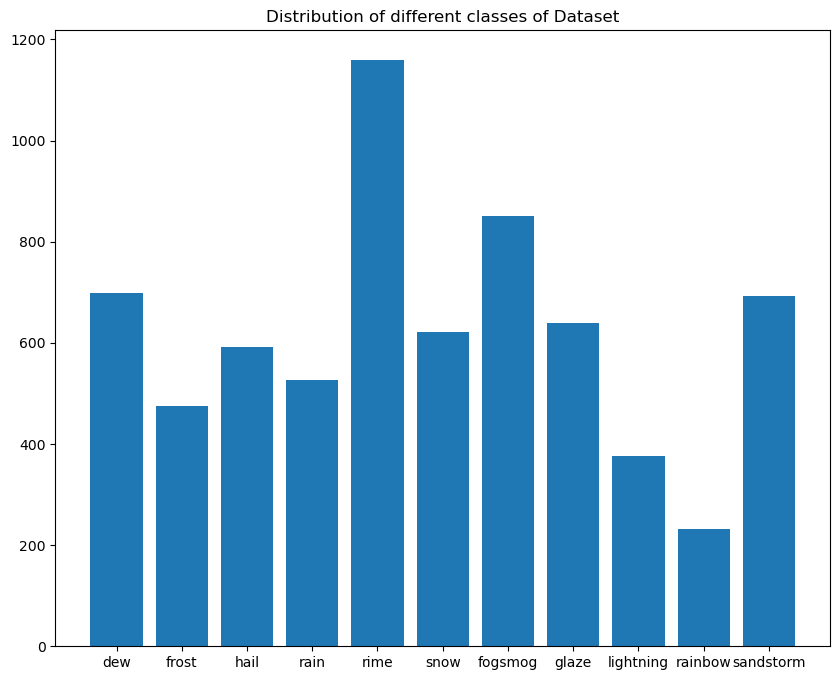

In [15]:
classes_list = ["dew", "frost", "hail", "rain", "rime", "snow", "fogsmog", "glaze", "lightning", "rainbow", "sandstorm"]
nimgs = {}
for i in classes_list:
    nimages = len(os.listdir('dataset/'+i+'/'))
    nimgs[i]=nimages
plt.figure(figsize=(10, 8))
plt.bar(range(len(nimgs)), list(nimgs.values()), align='center')
plt.xticks(range(len(nimgs)), list(nimgs.keys()))
plt.title('Distribution of different classes of Dataset')
plt.show()

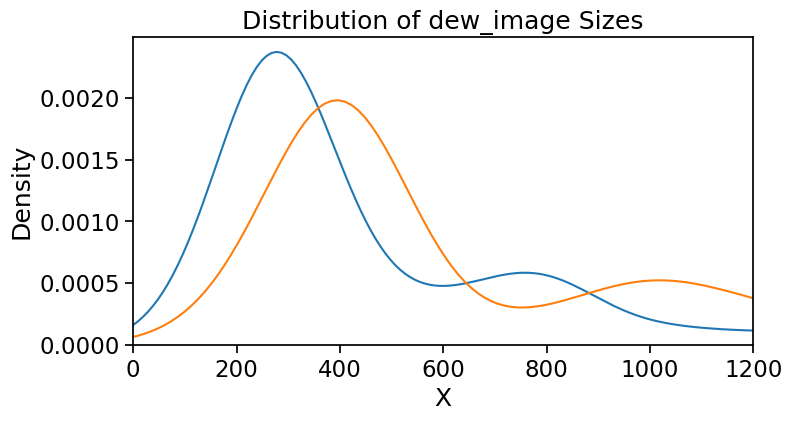

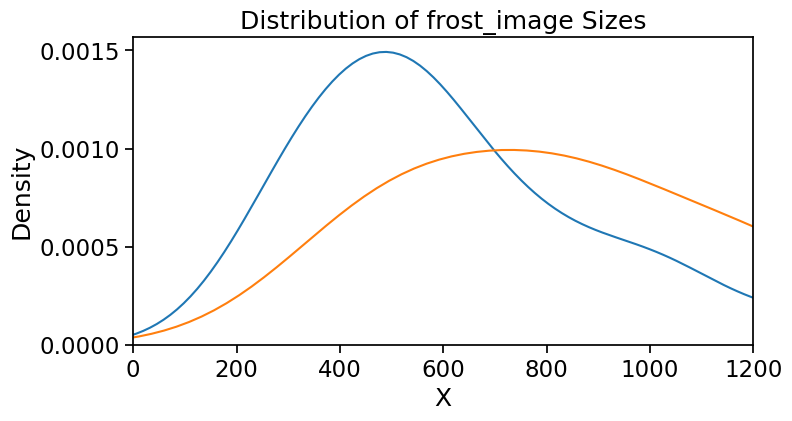

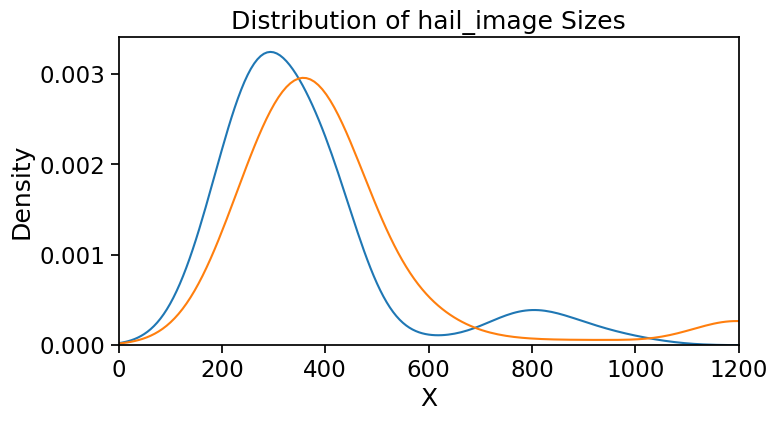

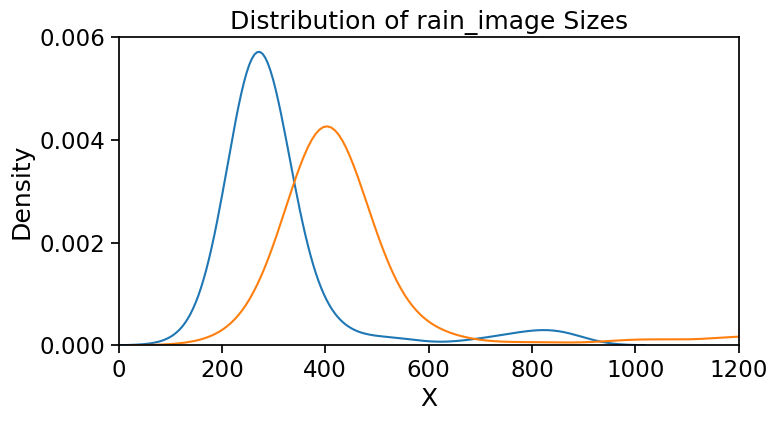

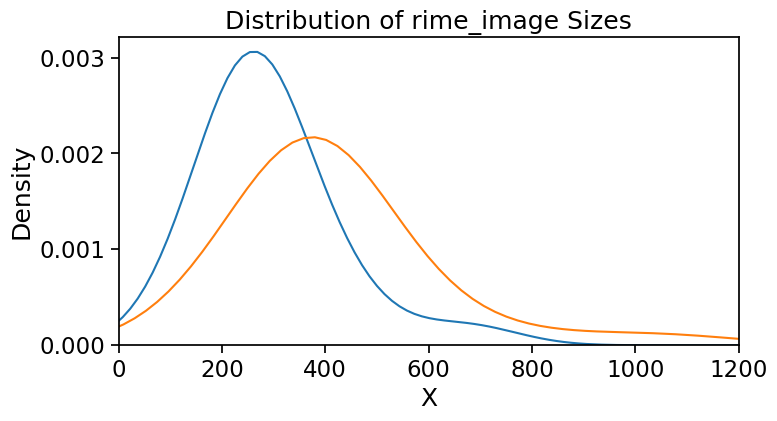

...

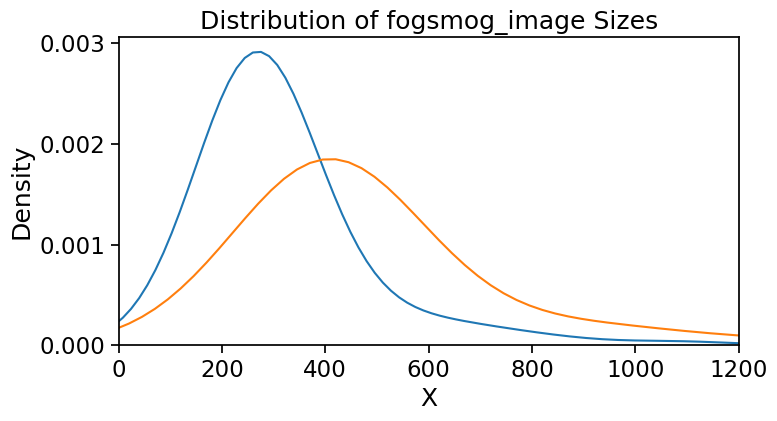

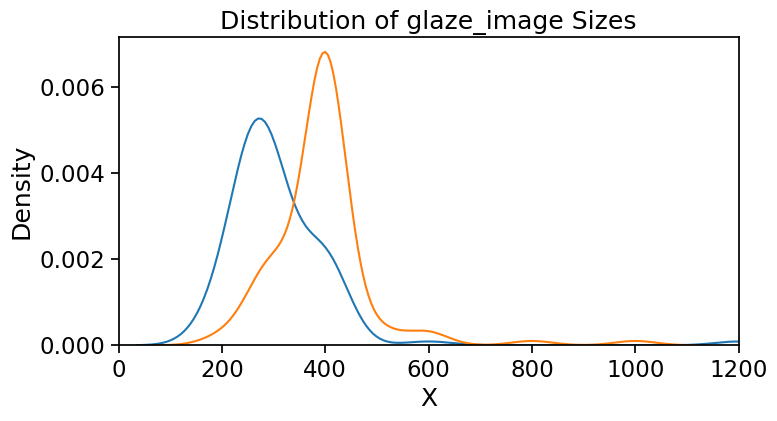

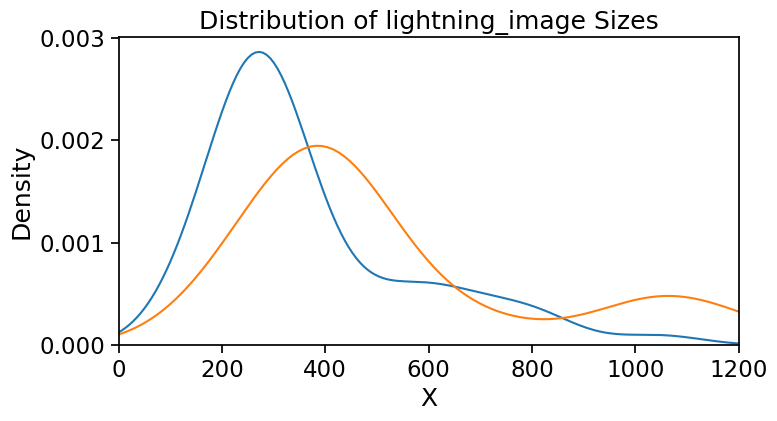

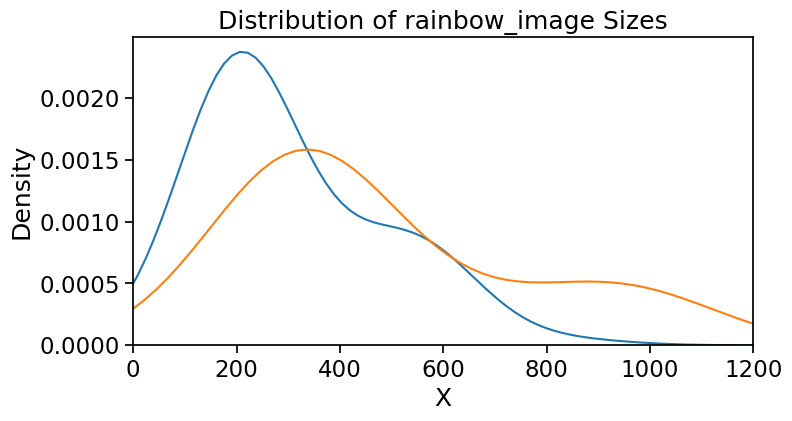

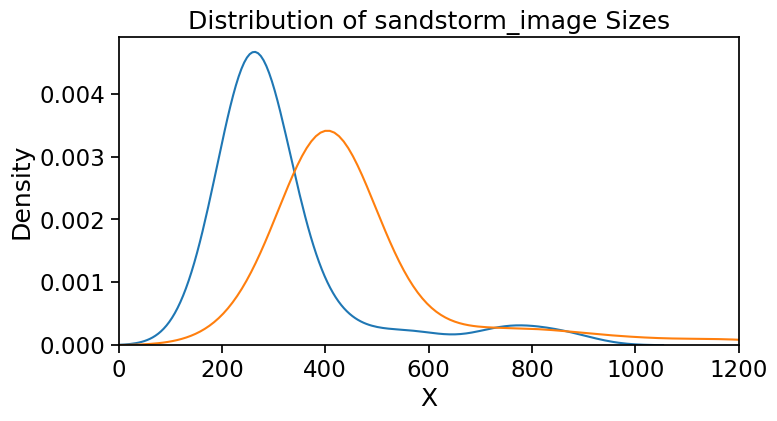

In [17]:

for i in classes_list:
    sample_images = list(pathlib.Path('dataset/'+i+'/').rglob('*/'))
    np.random.seed(42)
    rand_imgs = np.random.choice(sample_images, size=10*10)

    shapes = []
    for img in rand_imgs:
        shapes.append(imread(str(img)).shape)
    
    shapes = pd.DataFrame().assign(X=pd.Series(shapes).map(lambda s: s[0]), Y=pd.Series(shapes).map(lambda s: s[1]))
    
    plt.figure(figsize=(8, 4))
    sns.set_context("notebook", font_scale=1.5)
    sns.kdeplot(shapes['X'])
    sns.kdeplot(shapes['Y'])
    plt.xlim(0, 1200)
    plt.title('Distribution of {}_image Sizes'.format(i))
    ax = plt.gca()
    ax.set_xlim(0, ax.get_xlim()[1])

In [48]:
!rm -rf weather_pred

In [18]:
try:
    os.mkdir('weather_pred')
    os.mkdir('weather_pred/Data')
    os.mkdir('weather_pred/Data/training')
    os.mkdir('weather_pred/Data/validation')
    
    for cls in classes_list:
        os.mkdir(f'weather_pred/Data/training/{cls}')
        os.mkdir(f'weather_pred/Data/validation/{cls}')
except OSError as osE:
    print(osE)

In [19]:
!ls -R weather_pred

weather_pred:
Data

weather_pred/Data:
training  validation

weather_pred/Data/training:
dew	 frost	hail	   rain     rime       snow
fogsmog  glaze	lightning  rainbow  sandstorm

weather_pred/Data/training/dew:

weather_pred/Data/training/fogsmog:

weather_pred/Data/training/frost:

weather_pred/Data/training/glaze:

weather_pred/Data/training/hail:

weather_pred/Data/training/lightning:

weather_pred/Data/training/rain:

weather_pred/Data/training/rainbow:

weather_pred/Data/training/rime:

weather_pred/Data/training/sandstorm:

weather_pred/Data/training/snow:

weather_pred/Data/validation:
dew	 frost	hail	   rain     rime       snow
fogsmog  glaze	lightning  rainbow  sandstorm

weather_pred/Data/validation/dew:

weather_pred/Data/validation/fogsmog:

weather_pred/Data/validation/frost:

weather_pred/Data/validation/glaze:

weather_pred/Data/validation/hail:

weather_pred/Data/validation/lightning:

weather_pred/Data/validation/rain:

weather_pred/Data/validation/rainbow:

weather_pr

In [21]:
def split_data(SOURCE, TRAINING, VALIDATION, SPLIT_SIZE):
    files = []
    for filename in os.listdir(SOURCE):
        file = SOURCE + filename
        if os.path.getsize(file) > 0:
            files.append(filename)
        else:
            print(filename + " is zero length, so ignoring.")

    training_length = int(len(files) * SPLIT_SIZE)
    valid_length = int(len(files) - training_length)
    shuffled_set = random.sample(files, len(files))
    training_set = shuffled_set[0:training_length]
    valid_set = shuffled_set[training_length:]

    for filename in training_set:
        this_file = SOURCE + filename
        destination = TRAINING + filename
        copyfile(this_file, destination)

    for filename in valid_set:
        this_file = SOURCE + filename
        destination = VALIDATION + filename
        copyfile(this_file, destination)

In [75]:
SOURCE_DIR = 'dataset/'
TRAINING_DIR = 'weather_pred/Data/training/'
VALID_DIR = 'weather_pred/Data/validation/'

split_size = .80

for class_name in classes_list:
    split_data(SOURCE_DIR+class_name+"/", TRAINING_DIR+class_name+"/", VALID_DIR+class_name+"/", split_size)
    print(f"copying from {SOURCE_DIR+class_name} to {TRAINING_DIR+class_name} and {VALID_DIR+class_name}")
    

copying from dataset/dew to weather_pred/Data/training/dew and weather_pred/Data/validation/dew
copying from dataset/frost to weather_pred/Data/training/frost and weather_pred/Data/validation/frost
copying from dataset/hail to weather_pred/Data/training/hail and weather_pred/Data/validation/hail
copying from dataset/rain to weather_pred/Data/training/rain and weather_pred/Data/validation/rain
copying from dataset/rime to weather_pred/Data/training/rime and weather_pred/Data/validation/rime
copying from dataset/snow to weather_pred/Data/training/snow and weather_pred/Data/validation/snow
copying from dataset/fogsmog to weather_pred/Data/training/fogsmog and weather_pred/Data/validation/fogsmog
copying from dataset/glaze to weather_pred/Data/training/glaze and weather_pred/Data/validation/glaze
copying from dataset/lightning to weather_pred/Data/training/lightning and weather_pred/Data/validation/lightning
copying from dataset/rainbow to weather_pred/Data/training/rainbow and weather_pre

In [98]:
# for cl in classes_list:
#     if nimgs[cl] > 280 :
#         list_filename = os.listdir('weather_pred/Data/training/'+cl+'/')
#         del_count = 0
#         for img in list_filename[280:] :
#             del_count+=1
# #             print(f"menghapus >> {cl} / {img}")
#             os.system(f"rm weather_pred/Data/training/{cl}/{img} ")
# #         print(f"deleted {del_count} from {cl} {nimgs[cl]}")

In [ ]:
print)

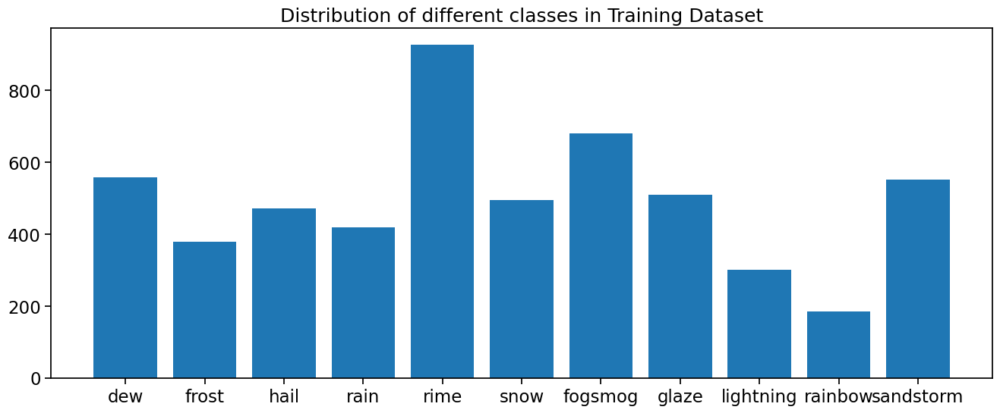

In [23]:
nimgs = {}
for i in classes_list:
    nimages = len(os.listdir('weather_pred/Data/training/'+i+'/'))
    nimgs[i]=nimages
plt.figure(figsize=(16, 6))
plt.bar(range(len(nimgs)), list(nimgs.values()), align='center')
plt.xticks(range(len(nimgs)), list(nimgs.keys()))
plt.title('Distribution of different classes in Training Dataset')
plt.show()

## Konfigurasi Hyperparameter 

In [24]:

img_width=256
img_height=256
batch_size=33

In [25]:
TRAINING_DIR = 'weather_pred/Data/training/'

train_datagen = ImageDataGenerator(preprocessing_function=preprocess_input,
                                   rotation_range=30,
                                   zoom_range=0.2,
                                   horizontal_flip=True
                                   )




In [26]:

train_generator = train_datagen.flow_from_directory(TRAINING_DIR,
                                                    batch_size=batch_size,
                                                    class_mode='categorical',
                                                    target_size=(img_height, img_width))


Found 5484 images belonging to 11 classes.


In [27]:
VALIDATION_DIR = 'weather_pred/Data/validation/'

validation_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

validation_generator = validation_datagen.flow_from_directory(VALIDATION_DIR,
                                                              batch_size=batch_size,
                                                              class_mode='categorical',
                                                              target_size=(img_height, img_width)
                                                             )


Found 1378 images belonging to 11 classes.


In [28]:

validation_generator = validation_datagen.flow_from_directory(VALIDATION_DIR,
                                                              batch_size=batch_size,
                                                              class_mode='categorical',
                                                              target_size=(img_height, img_width)
                                                             )


Found 1378 images belonging to 11 classes.


In [29]:

callbacks = EarlyStopping(monitor='val_loss', patience=4, verbose=1, mode='auto')
best_model_file = '../vgg16_best_weights_256.h5'
best_model = ModelCheckpoint(best_model_file, monitor='val_acc', verbose = 1, save_best_only = True)
#reduce_lr = ReduceLROnPlateau(patience=5, monitor='val_acc', factor=0.1, min_lr=0.0000001, mode='auto', verbose=1)



# Building Model

In [30]:

# wp = '../vgg16_weights_tf_dim_ordering_tf_kernels_notop.h5'
vgg16_base = VGG16(include_top=False, weights="imagenet",
                   input_tensor=None, input_shape=(img_height, img_width, 3))


2023-07-14 06:17:54.366172: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:42] Overriding orig_value setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.


58889256/58889256 [==============================] - 0s 0us/step


In [31]:

print('Adding new layers...')
output = vgg16_base.get_layer(index = -1).output  
output = Flatten()(output)
# let's add a fully-connected layer
output = Dense(1024,activation = "relu")(output)
output = BatchNormalization()(output)
output = Dropout(0.2)(output)
output = Dense(1024,activation = "relu")(output)
output = BatchNormalization()(output)
output = Dropout(0.2)(output)
output = Dense(11, activation='softmax')(output)
print('New layers added!')


Adding new layers...
New layers added!


In [32]:

vgg16_model = Model(vgg16_base.input, output)
for layer in vgg16_model.layers[:-7]:
    layer.trainable = False
vgg16_model.summary()


Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 256, 256, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 256, 256, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 256, 256, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 128, 128, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 128, 128, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 128, 128, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 64, 64, 128)       0     

In [33]:

vgg16_model.compile(optimizer='Adam', loss='categorical_crossentropy',metrics =['accuracy'])


In [39]:

history = vgg16_model.fit(train_generator,
                              epochs=30,
                              verbose=1,
                              validation_data=validation_generator,
                              callbacks = [callbacks, best_model]
                              )


Epoch 1/30
167/167 [==============================] - 86s 515ms/step - loss: 0.4697 - accuracy: 0.8510 - val_loss: 0.5373 - val_accuracy: 0.8520
Epoch 2/30
167/167 [==============================] - 86s 512ms/step - loss: 0.4005 - accuracy: 0.8713 - val_loss: 0.5275 - val_accuracy: 0.8549
Epoch 3/30
167/167 [==============================] - 87s 519ms/step - loss: 0.3259 - accuracy: 0.8889 - val_loss: 0.4550 - val_accuracy: 0.8759
Epoch 4/30
167/167 [==============================] - 82s 491ms/step - loss: 0.3038 - accuracy: 0.8997 - val_loss: 0.5334 - val_accuracy: 0.8541
Epoch 5/30
167/167 [==============================] - 86s 516ms/step - loss: 0.2551 - accuracy: 0.9156 - val_loss: 0.4474 - val_accuracy: 0.8759
Epoch 6/30
167/167 [==============================] - 87s 520ms/step - loss: 0.2457 - accuracy: 0.9240 - val_loss: 0.4749 - val_accuracy: 0.8853
Epoch 7/30
167/167 [==============================] - 86s 515ms/step - loss: 0.2075 - accuracy: 0.9265 - val_loss: 0.5055 - val_ac

ERROR: Could not find a version that satisfies the requirement cudnn==7.6.5 (from versions: none)
ERROR: No matching distribution found for cudnn==7.6.5


In [40]:

target_dir = 'weather_pred/'
if not os.path.exists(target_dir):
  os.mkdir(target_dir)
vgg16_model.save(target_dir + 'vgg16_model_256.h5')
vgg16_model.save_weights(target_dir + 'vgg16_weights_256.h5')


In [41]:
vgg16_model.compile(optimizer='sgd', loss='categorical_crossentropy',metrics =['accuracy'])

- updating batch size from 4 to 32

In [42]:
history2 = vgg16_model.fit(train_generator,
                              epochs=3,
                              verbose=1,
                              validation_data=validation_generator,
                              callbacks = [callbacks, best_model]
                              )

Epoch 1/3
167/167 [==============================] - 86s 510ms/step - loss: 0.1509 - accuracy: 0.9513 - val_loss: 0.5175 - val_accuracy: 0.8817
Epoch 2/3
167/167 [==============================] - 86s 516ms/step - loss: 0.1534 - accuracy: 0.9458 - val_loss: 0.5126 - val_accuracy: 0.8817
Epoch 3/3
167/167 [==============================] - 87s 520ms/step - loss: 0.1399 - accuracy: 0.9524 - val_loss: 0.5164 - val_accuracy: 0.8824


# Evaluation


In [44]:
# training 1
acc=history.history['accuracy']
val_acc=history.history['val_accuracy']
loss=history.history['loss']
val_loss=history.history['val_loss']

epochs=range(len(acc))


# training 2
acc2=history2.history['accuracy']
val_acc2=history2.history['val_accuracy']
loss2=history2.history['loss']
val_loss2=history2.history['val_loss']

epochs2=range(len(acc2))

# # training 3
# acc3=history3.history['accuracy']
# val_acc3=history3.history['val_accuracy']
# loss3=history3.history['loss']
# val_loss3=history3.history['val_loss']

# epochs3=range(len(acc3))

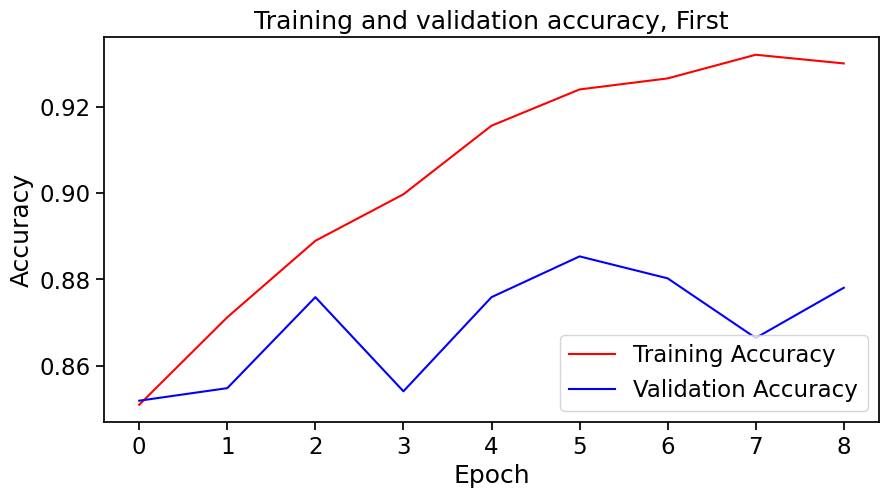

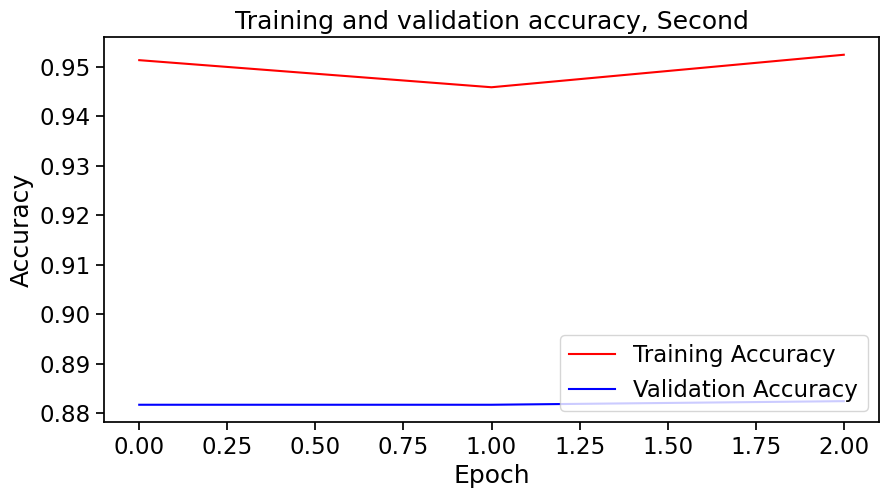

In [46]:

fig = plt.figure(figsize=(10,5))
plt.plot(epochs, acc, 'r', label="Training Accuracy")
plt.plot(epochs, val_acc, 'b', label="Validation Accuracy")
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Training and validation accuracy, First')
plt.legend(loc='lower right')
plt.show()

fig = plt.figure(figsize=(10,5))
plt.plot(epochs2, acc2, 'r', label="Training Accuracy")
plt.plot(epochs2, val_acc2, 'b', label="Validation Accuracy")
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Training and validation accuracy, Second')
plt.legend(loc='lower right')
plt.show()

# fig = plt.figure(figsize=(10,5))
# plt.plot(epochs3, acc3, 'r', label="Training Accuracy")
# plt.plot(epochs3, val_acc3, 'b', label="Validation Accuracy")
# plt.xlabel('Epoch')
# plt.ylabel('Accuracy')
# plt.title('Training and validation accuracy, Third')
# plt.legend(loc='lower right')
# plt.show()

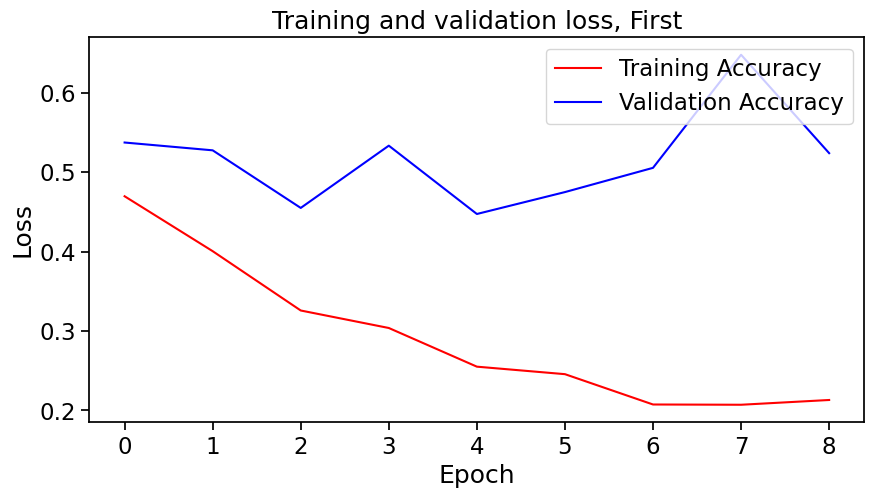

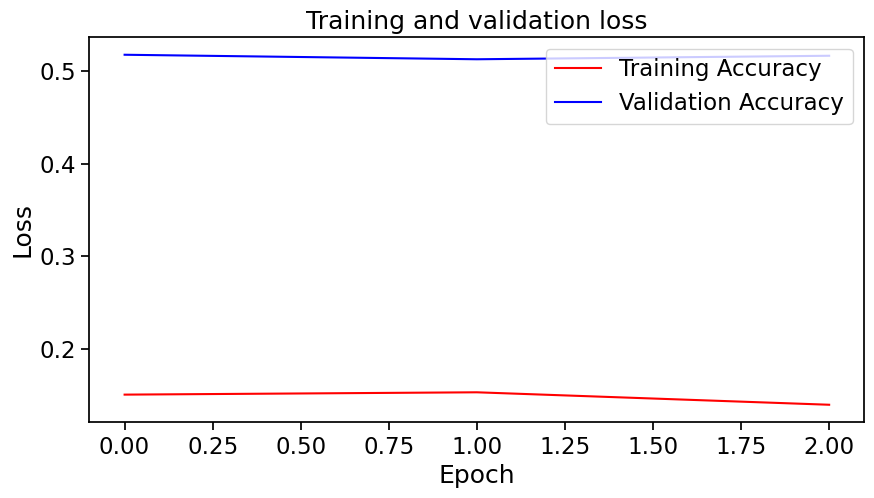

In [48]:
fig = plt.figure(figsize=(10,5))
plt.plot(epochs, loss, 'r', label="Training Accuracy")
plt.plot(epochs, val_loss, 'b', label="Validation Accuracy")
plt.legend(loc='upper right')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and validation loss, First')
plt.show()

fig = plt.figure(figsize=(10,5))
plt.plot(epochs2, loss2, 'r', label="Training Accuracy")
plt.plot(epochs2, val_loss2, 'b', label="Validation Accuracy")
plt.legend(loc='upper right')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and validation loss')
plt.show()

# fig = plt.figure(figsize=(10,5))
# plt.plot(epochs3, loss3, 'r', label="Training Accuracy")
# plt.plot(epochs3, val_loss3, 'b', label="Validation Accuracy")
# plt.legend(loc='upper right')
# plt.xlabel('Epoch')
# plt.ylabel('Loss')
# plt.title('Training and validation loss, Second')
# plt.show()

# fig2 = plt.figure(figsize=(10,5))
# plt.plot(epochs, loss, 'r', label="Training Loss")
# plt.plot(epochs, val_loss, 'b', label="Validation Loss")
# plt.legend(loc='upper right')
# plt.xlabel('Epoch')
# plt.ylabel('Loss')
# plt.title('Training and validation loss, Third')





## Confusion matrix

In [79]:
test_dataset = []
test_images = []

for cl in classes_list:
    print(cl)
    list_filename = os.listdir('weather_pred/Data/training/'+cl+'/')
    for i, num in enumerate([random.randint(0,len(list_filename)) for i in range(10)]):
        img = load_img(f"weather_pred/Data/training/{cl}/{list_filename[num]}", target_size = (img_height, img_width))
        test_images.append(img)
        a = img_to_array(img)
        
        a = np.expand_dims(a, axis = 0)
        a = preprocess_input(a)
        test_dataset.append(a)

    

dew
frost
hail
rain
rime
snow
fogsmog
glaze
lightning
rainbow
sandstorm


In [51]:
test_dataset = np.vstack(test_images)

In [52]:
test_dataset.shape

(110, 256, 256, 3)

In [56]:
array = vgg16_model.predict(test_dataset, batch_size=1, verbose=1)
y_pred = np.argmax(array, axis=1)

110/110 [==============================] - 1s 6ms/step


In [57]:
y_pred

array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  2,  2,  2,  2,  2,  2,  2,
        2,  2,  2,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  6,  6,  6,  6,
        6,  6,  6,  6,  6,  6,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8, 10,
       10, 10, 10, 10, 10, 10, 10, 10, 10,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  5,  5,  5,  5,  5,
        5,  5,  5,  5,  5,  7,  7,  7,  7,  7,  7,  7,  7,  7,  5,  9,  9,
        9,  9,  9,  9,  9,  9,  9,  9])

In [89]:

label_tokens = { 0 : "dew",
  2 : "frost",
  4 : "hail",
  6 : "rain",
  8 : "rime",
  10: "snow",
  1 : "fogsmog",
  3 : "glaze",
  5 : "lightning",
  7 : "rainbow",
  9 : "sandstorm"}

y_true = np.array([[0]*10,[2]*10,[4]*10,[6]*10,[8]*10,[10]*10,[1]*10,[3]*10,[5]*10,[7]*10,[9]*10]).flatten()
y_true

array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  2,  2,  2,  2,  2,  2,  2,
        2,  2,  2,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  6,  6,  6,  6,
        6,  6,  6,  6,  6,  6,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8, 10,
       10, 10, 10, 10, 10, 10, 10, 10, 10,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  5,  5,  5,  5,  5,
        5,  5,  5,  5,  5,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  9,  9,
        9,  9,  9,  9,  9,  9,  9,  9])

In [66]:
from sklearn.metrics import confusion_matrix
conf_mat = confusion_matrix(y_true, y_pred)

In [67]:
import itertools
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Reds):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        cm = cm.round(2)
        #print("Normalized confusion matrix")
    else:
        cm=cm
        #print('Confusion matrix, without normalization')

    #print(cm)

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

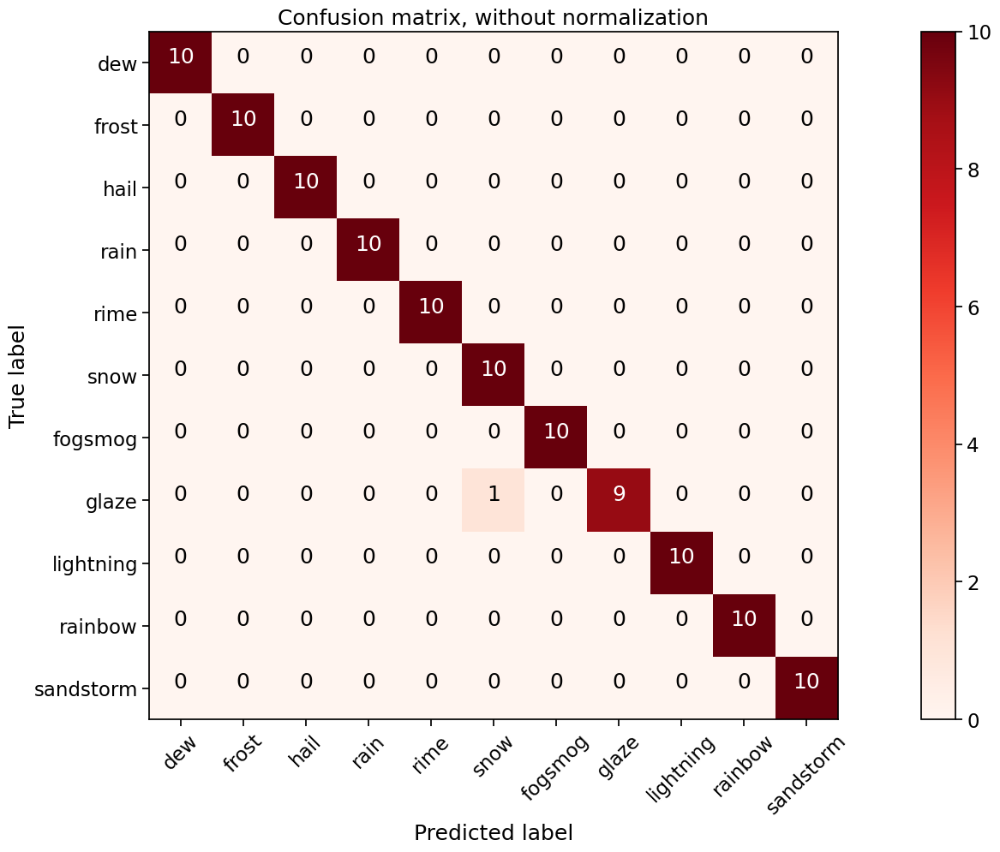

In [71]:
np.set_printoptions(precision=2)

fig1 = plt.figure(figsize=(20,10))
plot_confusion_matrix(conf_mat, classes=classes_list, title='Confusion matrix, without normalization')
#fig1.savefig('../cm_wo_norm.jpg')
plt.show()

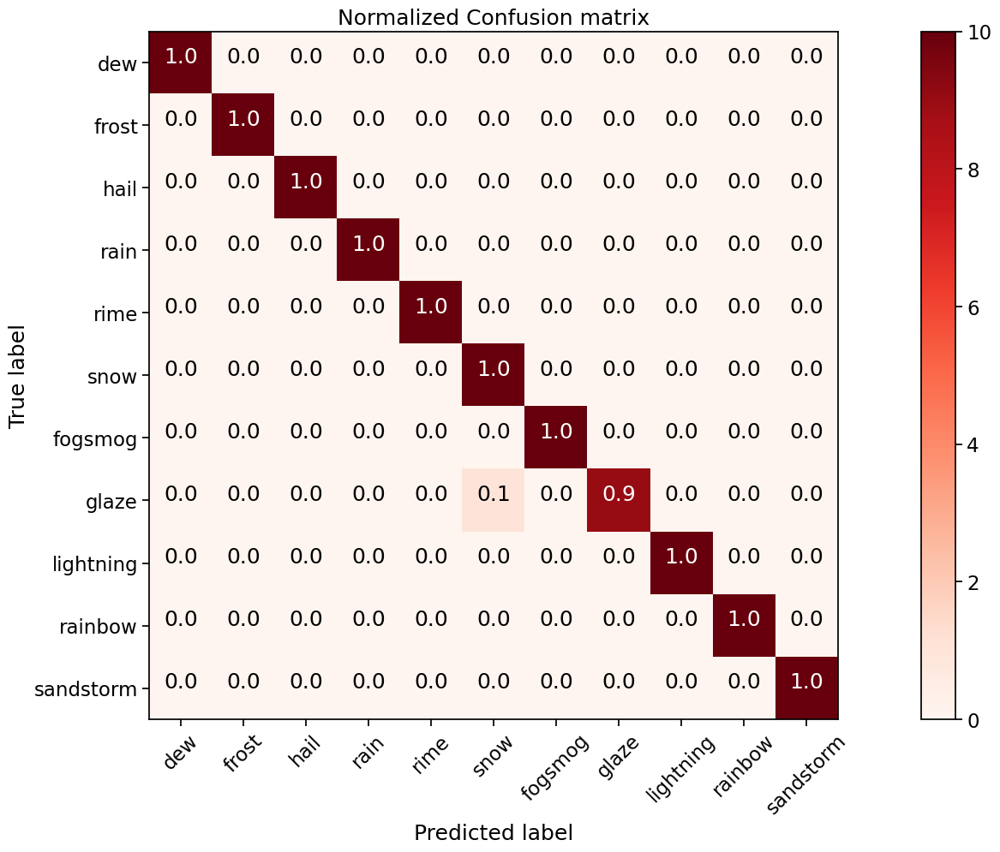

In [70]:
np.set_printoptions(precision=2)

fig2 = plt.figure(figsize=(20,10))
plot_confusion_matrix(conf_mat, classes=classes_list, normalize = True, title='Normalized Confusion matrix')
fig2.savefig('../cm_norm.jpg')
plt.show()

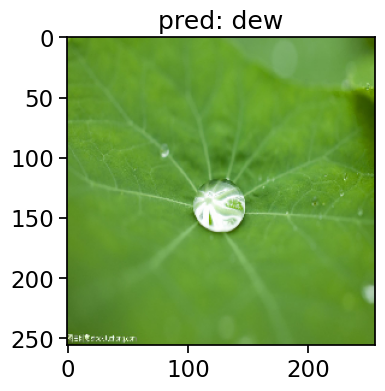

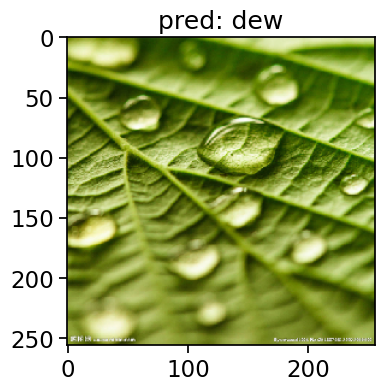

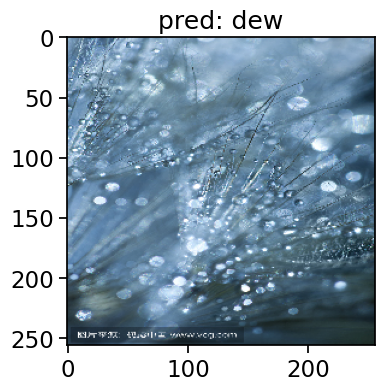

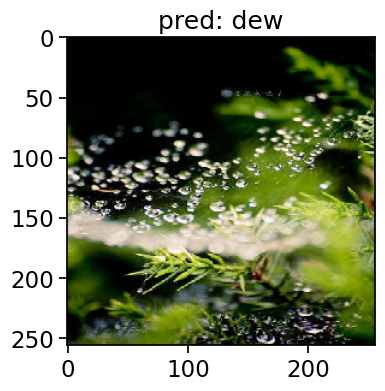

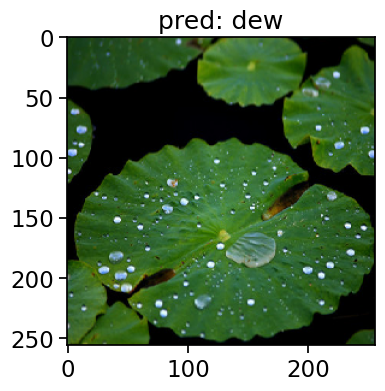

...

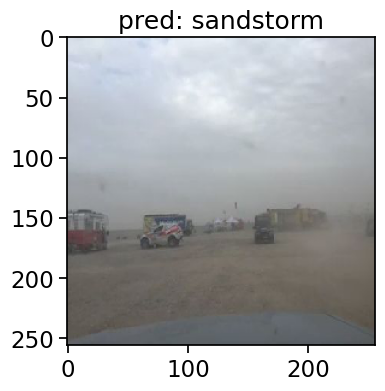

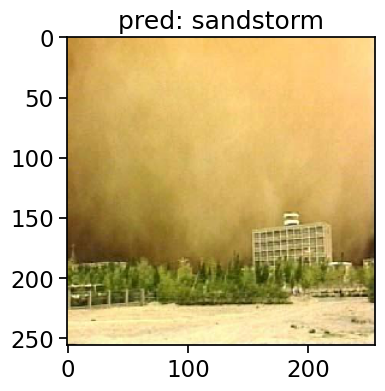

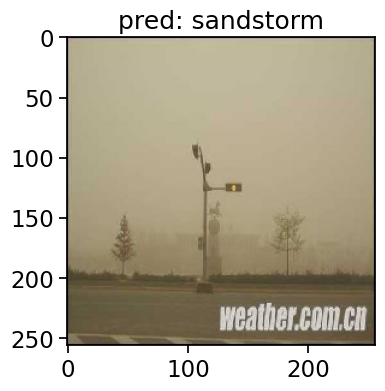

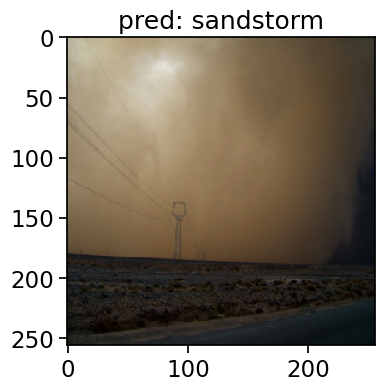

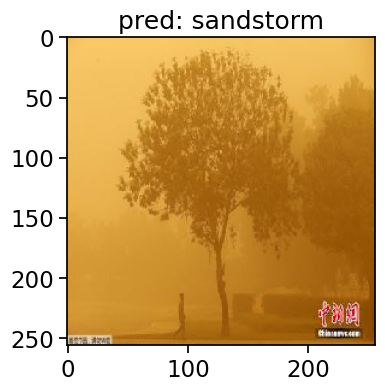

In [107]:
import math
for i, img in enumerate(test_images): 
    plt.figure( figsize=(4,4))
    plt.imshow(img)
    plt.title(f"pred: {label_tokens[y_pred[i]]}")
    plt.show()
